<h1 style = 'color:#FF0000; font-family: Georgia, serif; font-size:60px'>
    Final Capstone Project: <br>
    Segmentation of Places
</h1>

-Author: Hriday Agrawal <br>
-Summer Analytics ID: 41395

<p align = 'center'> <img src = 'https://media.istockphoto.com/photos/network-gps-navigation-modern-city-future-technology-picture-id1147315118?k=20&m=1147315118&s=612x612&w=0&h=fNPvbK5s8hG70T9_EVS2c5UyAnG5yo9_Yn0Viwj_hKU=', height = 40px></p>

### Problem Statement: Segmentation of places 

You will be given POI (Point of Interest) data from OSM (openstreetmaps).
These POIs will include locations ranging from grocery stores, shopping malls
to car dealerships within the city. You may also enrich your POI (point of
interest, meaning, what type of place- showroom/ building/ outlet/ shop etc.)
data using any location data available on the web (that you can
extract/scrape).
<br><br>
Your goal is to divide the city geographically into various
blocks/localities. Next you are supposed to create clusters of similar localities
and characterize each cluster so that these clusters are human interpretable.
Note that we will be evaluating your solution based on actionable insights you
are able to draw from EDA (exploratory data analysis ) and the clusters. As a
side note feel free to use the IFA data into your solution if it seems useful.
Examples of insights are given below:


<br>
Cluster 1 (name should be given to each cluster) has a high range of rates for
commercial spaces ( ~Rs. 40000/per sqft ) and also has presence of premium
cafes and pubs. Overall the correlation between commercial rates and
number of pubs/premium cafes in Mumbai is 0.8.


<br> 
Cluster 5 has a high volume of grocer


In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Plotting libraries
import matplotlib.pyplot as plt
import seaborn as sns

# Mapping Libraries
import folium
from folium.plugins import MarkerCluster

# suppressing warnings
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

In [2]:
df = pd.read_csv('Dataset 1.csv')
df

,source,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
0,OSM,POI_1003_6612393918,Parle,shop.food.bakery,13.049754,77.492895,NaN,Bangalore,Karnataka,India,NaN,NaN
1,OSM,POI_1003_6613030600,The Black Pearl,food.restaurant,12.939213,77.694701,NaN,Bangalore,Karnataka,India,NaN,NaN
2,OSM,POI_1003_4668296373,Temple,NaN,12.940448,77.693816,NaN,Bangalore,Karnataka,India,NaN,NaN
3,OSM,POI_1003_3771995983,Kadubeesanahalli Underpass,NaN,12.939450,77.695305,NaN,Bangalore,Karnataka,India,NaN,NaN
4,OSM,POI_1003_2413350412,NaN,health.wellbeing.swimming_pool,12.940660,77.693607,NaN,Bangalore,Karnataka,India,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
42925,OSM,POI_1003_3740962178,NaN,NaN,12.976237,77.611640,NaN,Bangalore,Karnataka,India,NaN,NaN
42926,OSM,POI_1003_3740962179,NaN,NaN,12.976275,77.611514,NaN,Bangalore,Karnataka,India,NaN,NaN
42927,OSM,POI_1003_3740962181,NaN,NaN,12.976317,77.611396,NaN,Bangalore,Karnataka,India,NaN,NaN
42928,OSM,POI_1003_3742106925,Soudhamani Estate NSB,NaN,12.821388,77.511637,NaN,Bangalore,Karnataka,India,560082,NaN


In [3]:
df.isnull().sum()

source          0
poi_code        0
name        12944
poi_type    20529
lat             0
long            0
address     40267
city            0
state           0
country         0
pin_code    34977
brand       41849
dtype: int64

In [4]:
df.describe(include = 'all')

,source,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
count,42930,42930,29986,22401,42930.000000,42930.000000,2663,42930,42930,42930,7953,1081
unique,1,42930,23461,148,NaN,NaN,2424,2,2,1,313,226
top,OSM,POI_1003_6612393918,State Bank of India,food.restaurant,NaN,NaN,"Banashankari, Bengaluru",Bangalore,Karnataka,India,400050,State Bank of India
freq,42930,1,219,2544,NaN,NaN,17,30417,30417,42930,231,74
mean,NaN,NaN,NaN,NaN,14.748122,76.226370,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,2.770391,2.159893,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,12.663725,72.782199,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,12.959939,72.919214,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,12.994515,77.579753,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,18.951006,77.633786,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
df.state.unique() # there are only 2 unique states Karnataka and Maharashtra

array(['Karnataka', 'Maharashtra'], dtype=object)

In [6]:
df.city.unique()

array(['Bangalore', 'Mumbai'], dtype=object)

In [7]:
df['city'].value_counts().sum()

42930

In [8]:
df['state'].value_counts().sum()

42930

In [9]:
df.pin_code.unique()

array([nan, '560103', '400007', '400066', '560102', '560008', '560038',
       '560075', '560066', '560042', '560039', '400005', '400001',
       '400039', '400050', '400099', '560064', '560106', '560071',
       '570008', '560058', '560022', '560034', '400034', '560010',
       '560001', '560053', '560085', '560004', '560086', '560040',
       '560054', '560021', '844101', '400067', '400059', '560011',
       '560068', '- 560068', '560009', '560025', '560027', '560051',
       '560047', '560010,', '560003', '560070', '560082', '560037',
       '560029', '584101', '560002', '400080', '562102', '560055',
       '628008', '560097', '560078', '560076', '400057', '400081',
       '400042', '560030', '560100', '562157', '560001ph', '560026',
       '560092', '560079', '560046', '560041', '400082', '400076',
       '700076', '400055', '400072', '400002', '400089', '400051',
       '560095', '560090', '560060', '560098', '400023', '560059',
       '570026', '560056', '560 025', '400054', '560

# Geoencoding the Lattitudes and Longitudes to get Pincodes

In [10]:
# from geopy import Nominatim
# from geopy.extra.rate_limiter import RateLimiter

# geolocator = Nominatim(user_agent = 'application')
# reverse = RateLimiter(geolocator.reverse, min_delay_seconds=1)

In [11]:
# # creating an address list:
# addresses = []
# step_cnt = 0
# # Address list is filled up by reverse geocoder function
# # Latitudes and longitudes are the list of respective coordinates
# def rev_geocoder(df, address, step_cnt):
#     for i,j in zip(df.lat, df.long):
#         address.append(geolocator.reverse((i,j), language = 'en', timeout = None))
#         print(address[step_cnt])
#         step_cnt += 1
        
# rev_geocoder(df, addresses, step_cnt)


In [12]:
# addr_list = pd.DataFrame({'addresses':addresses})

In [13]:
# addr_list.to_csv('addresses.csv')

<div class = 'alert alert-success'>
    The above commented codeblocks were already executed to extract all the addresses via Reverse Geocoding, and stored in a new csv file named <strong>'addresses.csv'</strong>
    <div>

In [14]:
df_add = pd.read_csv('./addresses.csv')
df_add.set_index('index')

,addresses
index,
0,"Parle, Bangalore - Nelamangala Expressway, Dod..."
1,"The Black Pearl, Service Road, Aricent Group, ..."
2,"Temple, Service Road, Aricent Group, Bellandur..."
3,"Kadubeesanahalli Underpass, Panathur Main Road..."
4,"Temple, Service Road, Aricent Group, Bellandur..."
...,...
42925,"Cubbon Road, Tasker Town, Sampangiram Nagar Wa..."
42926,"Cubbon Road, Tasker Town, Sampangiram Nagar Wa..."
42927,"Cubbon Road, Tasker Town, Sampangiram Nagar Wa..."


In [15]:
df.address = df_add.addresses

In [16]:
df.head()

,source,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
0,OSM,POI_1003_6612393918,Parle,shop.food.bakery,13.049754,77.492895,"Parle, Bangalore - Nelamangala Expressway, Dod...",Bangalore,Karnataka,India,NaN,NaN
1,OSM,POI_1003_6613030600,The Black Pearl,food.restaurant,12.939213,77.694701,"The Black Pearl, Service Road, Aricent Group, ...",Bangalore,Karnataka,India,NaN,NaN
2,OSM,POI_1003_4668296373,Temple,NaN,12.940448,77.693816,"Temple, Service Road, Aricent Group, Bellandur...",Bangalore,Karnataka,India,NaN,NaN
3,OSM,POI_1003_3771995983,Kadubeesanahalli Underpass,NaN,12.939450,77.695305,"Kadubeesanahalli Underpass, Panathur Main Road...",Bangalore,Karnataka,India,NaN,NaN
4,OSM,POI_1003_2413350412,NaN,health.wellbeing.swimming_pool,12.940660,77.693607,"Temple, Service Road, Aricent Group, Bellandur...",Bangalore,Karnataka,India,NaN,NaN


In [17]:
for i in range(len(df.name)):
    if not df.loc[i, 'name'] == 'nan':
        df.loc[i, 'name'] = df.loc[i, 'address'].split(',')[0]

In [18]:
df.isna().sum()

source          0
poi_code        0
name            0
poi_type    20529
lat             0
long            0
address         0
city            0
state           0
country         0
pin_code    34977
brand       41849
dtype: int64

In [19]:
# dropping brand column, too many null values for any usage.
df.brand.replace(np.nan, 'No Brand Available', inplace = True)

In [20]:
df

,source,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
0,OSM,POI_1003_6612393918,Parle,shop.food.bakery,13.049754,77.492895,"Parle, Bangalore - Nelamangala Expressway, Dod...",Bangalore,Karnataka,India,NaN,No Brand Available
1,OSM,POI_1003_6613030600,The Black Pearl,food.restaurant,12.939213,77.694701,"The Black Pearl, Service Road, Aricent Group, ...",Bangalore,Karnataka,India,NaN,No Brand Available
2,OSM,POI_1003_4668296373,Temple,NaN,12.940448,77.693816,"Temple, Service Road, Aricent Group, Bellandur...",Bangalore,Karnataka,India,NaN,No Brand Available
3,OSM,POI_1003_3771995983,Kadubeesanahalli Underpass,NaN,12.939450,77.695305,"Kadubeesanahalli Underpass, Panathur Main Road...",Bangalore,Karnataka,India,NaN,No Brand Available
4,OSM,POI_1003_2413350412,Temple,health.wellbeing.swimming_pool,12.940660,77.693607,"Temple, Service Road, Aricent Group, Bellandur...",Bangalore,Karnataka,India,NaN,No Brand Available
...,...,...,...,...,...,...,...,...,...,...,...,...
42925,OSM,POI_1003_3740962178,Cubbon Road,NaN,12.976237,77.611640,"Cubbon Road, Tasker Town, Sampangiram Nagar Wa...",Bangalore,Karnataka,India,NaN,No Brand Available
42926,OSM,POI_1003_3740962179,Cubbon Road,NaN,12.976275,77.611514,"Cubbon Road, Tasker Town, Sampangiram Nagar Wa...",Bangalore,Karnataka,India,NaN,No Brand Available
42927,OSM,POI_1003_3740962181,Cubbon Road,NaN,12.976317,77.611396,"Cubbon Road, Tasker Town, Sampangiram Nagar Wa...",Bangalore,Karnataka,India,NaN,No Brand Available
42928,OSM,POI_1003_3742106925,Soudhamani Estate NSB,NaN,12.821388,77.511637,"Soudhamani Estate NSB, Kanakapura Road, Udayap...",Bangalore,Karnataka,India,560082,No Brand Available


In [21]:
# dropping source column, as it has only single entry
df.drop('source', axis = 1, inplace = True)

In [22]:
df.head()

,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
0,POI_1003_6612393918,Parle,shop.food.bakery,13.049754,77.492895,"Parle, Bangalore - Nelamangala Expressway, Dod...",Bangalore,Karnataka,India,NaN,No Brand Available
1,POI_1003_6613030600,The Black Pearl,food.restaurant,12.939213,77.694701,"The Black Pearl, Service Road, Aricent Group, ...",Bangalore,Karnataka,India,NaN,No Brand Available
2,POI_1003_4668296373,Temple,NaN,12.940448,77.693816,"Temple, Service Road, Aricent Group, Bellandur...",Bangalore,Karnataka,India,NaN,No Brand Available
3,POI_1003_3771995983,Kadubeesanahalli Underpass,NaN,12.939450,77.695305,"Kadubeesanahalli Underpass, Panathur Main Road...",Bangalore,Karnataka,India,NaN,No Brand Available
4,POI_1003_2413350412,Temple,health.wellbeing.swimming_pool,12.940660,77.693607,"Temple, Service Road, Aricent Group, Bellandur...",Bangalore,Karnataka,India,NaN,No Brand Available


In [23]:
# filling in pincodes

splitted_addresses = df['address'].str.split(',').to_list()

# Format:
splitted_addresses[0:2]

[['Parle',
  ' Bangalore - Nelamangala Expressway',
  ' Dodda Bidarakallu',
  ' Rajarajeshwari Nagar Zone',
  ' Bengaluru',
  ' Bangalore North',
  ' Bangalore Urban',
  ' Karnataka',
  ' 560073',
  ' India'],
 ['The Black Pearl',
  ' Service Road',
  ' Aricent Group',
  ' Bellanduru',
  ' Mahadevapura Zone',
  ' Bengaluru',
  ' Bangalore East',
  ' Bangalore Urban',
  ' Karnataka',
  ' 560037',
  ' India']]

In [24]:
pincodes = pd.Series([i[-2] for i in splitted_addresses])
freqs = dict(pincodes.value_counts())

In [25]:
# Removing all occurances of rows from df with unavailable pincodes

df.pin_code = pincodes
df

,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
0,POI_1003_6612393918,Parle,shop.food.bakery,13.049754,77.492895,"Parle, Bangalore - Nelamangala Expressway, Dod...",Bangalore,Karnataka,India,560073,No Brand Available
1,POI_1003_6613030600,The Black Pearl,food.restaurant,12.939213,77.694701,"The Black Pearl, Service Road, Aricent Group, ...",Bangalore,Karnataka,India,560037,No Brand Available
2,POI_1003_4668296373,Temple,NaN,12.940448,77.693816,"Temple, Service Road, Aricent Group, Bellandur...",Bangalore,Karnataka,India,560037,No Brand Available
3,POI_1003_3771995983,Kadubeesanahalli Underpass,NaN,12.939450,77.695305,"Kadubeesanahalli Underpass, Panathur Main Road...",Bangalore,Karnataka,India,560037,No Brand Available
4,POI_1003_2413350412,Temple,health.wellbeing.swimming_pool,12.940660,77.693607,"Temple, Service Road, Aricent Group, Bellandur...",Bangalore,Karnataka,India,560037,No Brand Available
...,...,...,...,...,...,...,...,...,...,...,...
42925,POI_1003_3740962178,Cubbon Road,NaN,12.976237,77.611640,"Cubbon Road, Tasker Town, Sampangiram Nagar Wa...",Bangalore,Karnataka,India,560042,No Brand Available
42926,POI_1003_3740962179,Cubbon Road,NaN,12.976275,77.611514,"Cubbon Road, Tasker Town, Sampangiram Nagar Wa...",Bangalore,Karnataka,India,560042,No Brand Available
42927,POI_1003_3740962181,Cubbon Road,NaN,12.976317,77.611396,"Cubbon Road, Tasker Town, Sampangiram Nagar Wa...",Bangalore,Karnataka,India,560042,No Brand Available
42928,POI_1003_3742106925,Soudhamani Estate NSB,NaN,12.821388,77.511637,"Soudhamani Estate NSB, Kanakapura Road, Udayap...",Bangalore,Karnataka,India,560082,No Brand Available


In [26]:
# selecting entries where pin numbers do no consist of strings ' Karnataka' and ' Maharashtra'
df = df[(df.pin_code != ' Karnataka') & (df.pin_code != ' Maharashtra')]

In [27]:
df.reset_index(inplace = True)

In [28]:
# Converting all entries in pincode column to integer datatype.
int_pins = df.loc[:,'pin_code'].astype('int')
df.loc[:,'pin_code'] = int_pins

In [29]:
df.dtypes

index         int64
poi_code     object
name         object
poi_type     object
lat         float64
long        float64
address      object
city         object
state        object
country      object
pin_code      int64
brand        object
dtype: object

In [30]:
# dropping entries with duplicate addresses
df = df.drop_duplicates(subset = 'address')
df.reset_index(inplace = True)
df

,level_0,index,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
0,0,0,POI_1003_6612393918,Parle,shop.food.bakery,13.049754,77.492895,"Parle, Bangalore - Nelamangala Expressway, Dod...",Bangalore,Karnataka,India,560073,No Brand Available
1,1,1,POI_1003_6613030600,The Black Pearl,food.restaurant,12.939213,77.694701,"The Black Pearl, Service Road, Aricent Group, ...",Bangalore,Karnataka,India,560037,No Brand Available
2,2,2,POI_1003_4668296373,Temple,NaN,12.940448,77.693816,"Temple, Service Road, Aricent Group, Bellandur...",Bangalore,Karnataka,India,560037,No Brand Available
3,3,3,POI_1003_3771995983,Kadubeesanahalli Underpass,NaN,12.939450,77.695305,"Kadubeesanahalli Underpass, Panathur Main Road...",Bangalore,Karnataka,India,560037,No Brand Available
4,5,5,POI_1003_2738839664,Chef Baker's,food.restaurant.fast_food,12.939268,77.695406,"Chef Baker's, 20/5 Narayanaswamy Building, Out...",Bangalore,Karnataka,India,560037,No Brand Available
...,...,...,...,...,...,...,...,...,...,...,...,...,...
30809,42735,42907,POI_1003_3722417685,Kaveri Departmental Store,shop.supermarket,12.975686,77.667106,"Kaveri Departmental Store, GM Palya Main Road,...",Bangalore,Karnataka,India,560075,No Brand Available
30810,42736,42908,POI_1003_3739025171,Palm Groves,NaN,13.019078,77.719065,"Palm Groves, Old Madras Road, Shree Vinayaka L...",Bangalore,Karnataka,India,560036,No Brand Available
30811,42737,42909,POI_1003_3740962162,Manipal Center,NaN,12.975811,77.612946,"Manipal Center, Cubbon Road, Tasker Town, Samp...",Bangalore,Karnataka,India,560042,No Brand Available
30812,42756,42928,POI_1003_3742106925,Soudhamani Estate NSB,NaN,12.821388,77.511637,"Soudhamani Estate NSB, Kanakapura Road, Udayap...",Bangalore,Karnataka,India,560082,No Brand Available


In [31]:
df.drop(['level_0', 'index'], axis = 1, inplace = True)
df

,poi_code,name,poi_type,lat,long,address,city,state,country,pin_code,brand
0,POI_1003_6612393918,Parle,shop.food.bakery,13.049754,77.492895,"Parle, Bangalore - Nelamangala Expressway, Dod...",Bangalore,Karnataka,India,560073,No Brand Available
1,POI_1003_6613030600,The Black Pearl,food.restaurant,12.939213,77.694701,"The Black Pearl, Service Road, Aricent Group, ...",Bangalore,Karnataka,India,560037,No Brand Available
2,POI_1003_4668296373,Temple,NaN,12.940448,77.693816,"Temple, Service Road, Aricent Group, Bellandur...",Bangalore,Karnataka,India,560037,No Brand Available
3,POI_1003_3771995983,Kadubeesanahalli Underpass,NaN,12.939450,77.695305,"Kadubeesanahalli Underpass, Panathur Main Road...",Bangalore,Karnataka,India,560037,No Brand Available
4,POI_1003_2738839664,Chef Baker's,food.restaurant.fast_food,12.939268,77.695406,"Chef Baker's, 20/5 Narayanaswamy Building, Out...",Bangalore,Karnataka,India,560037,No Brand Available
...,...,...,...,...,...,...,...,...,...,...,...
30809,POI_1003_3722417685,Kaveri Departmental Store,shop.supermarket,12.975686,77.667106,"Kaveri Departmental Store, GM Palya Main Road,...",Bangalore,Karnataka,India,560075,No Brand Available
30810,POI_1003_3739025171,Palm Groves,NaN,13.019078,77.719065,"Palm Groves, Old Madras Road, Shree Vinayaka L...",Bangalore,Karnataka,India,560036,No Brand Available
30811,POI_1003_3740962162,Manipal Center,NaN,12.975811,77.612946,"Manipal Center, Cubbon Road, Tasker Town, Samp...",Bangalore,Karnataka,India,560042,No Brand Available
30812,POI_1003_3742106925,Soudhamani Estate NSB,NaN,12.821388,77.511637,"Soudhamani Estate NSB, Kanakapura Road, Udayap...",Bangalore,Karnataka,India,560082,No Brand Available


# <font color = 'red'> Aiding the data with Dataset 2 </font>

In [32]:
df_add = pd.read_csv('./Dataset 2.csv')
df_add

,UID,poi_code,poi_type,date
0,-2085240936,POI_1003_4538233794,food.restaurant.fast_food,2/20/2022
1,-2085240936,POI_1003_4538247791,food.restaurant,2/20/2022
2,-2085240936,POI_1003_4538247792,food.restaurant.fast_food,2/20/2022
3,-2085240936,POI_1003_4538286592,food.restaurant.fast_food,2/20/2022
4,-2085240936,POI_1003_4538286593,food.restaurant.fast_food,2/20/2022
...,...,...,...,...
171465,862508850,POI_1003_5867113900,service.finance.bank,2/20/2022
171466,1870722650,POI_1003_8802125729,health.hospital.general,2/20/2022
171467,-1375163550,POI_1003_4195979561,shop.food.butcher,2/20/2022
171468,-1195281550,POI_1003_1743939200,food.nightlife.bar_pub,2/20/2022


In [33]:
# Extracting unique numerical part out of poi_code to get easily comparable numbers (rather than strings)

df.poi_code = df.poi_code.str.replace('POI_1003_','').astype('int')
print(df.dtypes)

df_add.poi_code = df_add.poi_code.str.replace('POI_1003_','').astype('int')
print(df_add.dtypes)

poi_code      int64
name         object
poi_type     object
lat         float64
long        float64
address      object
city         object
state        object
country      object
pin_code      int64
brand        object
dtype: object
UID          int64
poi_code     int64
poi_type    object
date        object
dtype: object


# Combining both the datasets to remove null values from poi_type and enhancement

In [34]:
new_df = df.combine_first(df_add)
new_df.dropna(inplace = True)
new_df.isna().sum()

UID         0
address     0
brand       0
city        0
country     0
date        0
lat         0
long        0
name        0
pin_code    0
poi_code    0
poi_type    0
state       0
dtype: int64

In [35]:
new_df.head()

,UID,address,brand,city,country,date,lat,long,name,pin_code,poi_code,poi_type,state
0,-2085240936,"Parle, Bangalore - Nelamangala Expressway, Dod...",No Brand Available,Bangalore,India,2/20/2022,13.049754,77.492895,Parle,560073.0,6612393918,shop.food.bakery,Karnataka
1,-2085240936,"The Black Pearl, Service Road, Aricent Group, ...",No Brand Available,Bangalore,India,2/20/2022,12.939213,77.694701,The Black Pearl,560037.0,6613030600,food.restaurant,Karnataka
2,-2085240936,"Temple, Service Road, Aricent Group, Bellandur...",No Brand Available,Bangalore,India,2/20/2022,12.940448,77.693816,Temple,560037.0,4668296373,food.restaurant.fast_food,Karnataka
3,-2085240936,"Kadubeesanahalli Underpass, Panathur Main Road...",No Brand Available,Bangalore,India,2/20/2022,12.939450,77.695305,Kadubeesanahalli Underpass,560037.0,3771995983,food.restaurant.fast_food,Karnataka
4,-2085240936,"Chef Baker's, 20/5 Narayanaswamy Building, Out...",No Brand Available,Bangalore,India,2/20/2022,12.939268,77.695406,Chef Baker's,560037.0,2738839664,food.restaurant.fast_food,Karnataka


In [36]:
new_df.describe()

,UID,lat,long,pin_code,poi_code
count,3.081400e+04,30814.000000,30814.000000,30814.000000,3.081400e+04
mean,-5.302325e+07,14.514408,76.412643,518785.492536,4.588659e+09
std,1.238298e+09,2.657970,2.061097,71082.219392,2.298377e+09
min,-2.145917e+09,12.686007,72.782412,380068.000000,1.617324e+07
25%,-1.157334e+09,12.953048,72.971364,400101.000000,2.954413e+09
50%,-9.616244e+07,12.987741,77.583644,560034.000000,4.488053e+09
75%,1.006189e+09,18.916691,77.633091,560069.000000,6.584010e+09
max,2.146948e+09,19.265771,77.808056,844101.000000,9.427870e+09


# <font color = 'purple'> EDA </font>

In [37]:
frequencies = new_df.pin_code.value_counts().to_list()


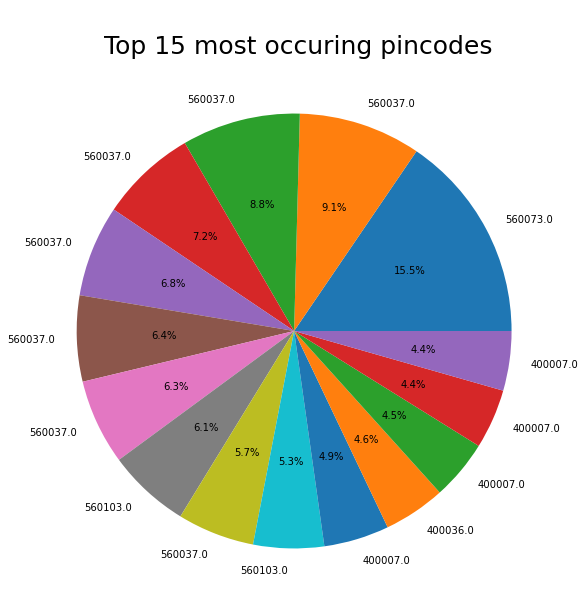

In [38]:
plt.figure(figsize = (10,10))
plt.pie(frequencies[:15], labels = new_df['pin_code'][:15], autopct = '%1.1f%%')
plt.title('\n Top 15 most occuring pincodes', fontdict = {'fontsize': 25})
plt.show()

Thus, 15.5% POI Areas have pincode 560073, 9.1% have 560037 and so on...
Thus, this area seems to be a main hub of various commercial activities. It can be big market for several commercial activities.

# Mapping the points

<AxesSubplot:>

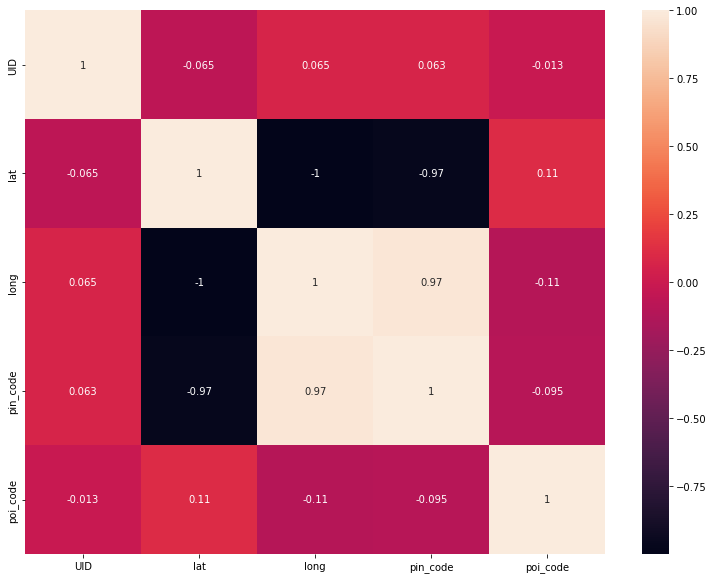

In [39]:
plt.figure(figsize = (13,10))
sns.heatmap(new_df.corr(), annot = True)

The above heatmap shows correlations between 5 features (poi_code, pin_code, UID, lat, long)

#### Few points to infer:

1. pin code column has high correlation with longitude and high negative correlation with latitude
2. UID and poi_code are almost independent of any other feature

In [40]:
# Creating a record of most favourite type of POI
# poi_type_freq_dict is a frequency dictionary and will store the frequencies of different POI_types.

poi_type_freq_dict = {}

for st in new_df.poi_type:
    st = set(st.split('.'))
    for poi in st:
        if poi in poi_type_freq_dict:
            poi_type_freq_dict[poi] += 1
        else:
            poi_type_freq_dict[poi] = 1
            
            
            
            

# creating a sorted dictionary to plot

sorted_dict = dict(sorted(poi_type_freq_dict.items(), key=lambda item: item[1]))

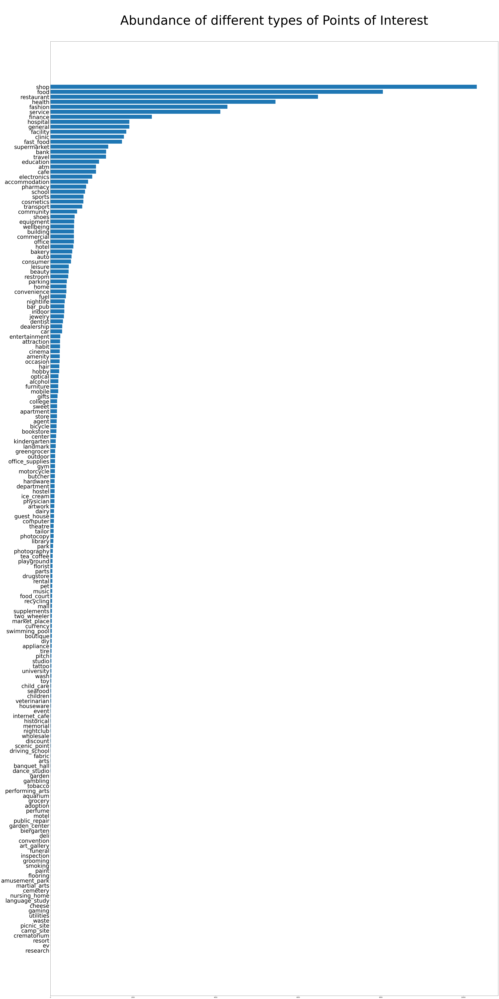

In [41]:
plt.figure(figsize = (50, 100))
plt.yticks(fontsize=40)
plt.title('\n Abundance of different types of Points of Interest \n ', fontdict = {'fontsize': 90})
plt.barh(y = list(sorted_dict.keys()), width = sorted_dict.values())
plt.tight_layout()
plt.show()

The above plot shows the abundance of different types of points of interest

The highest abundance is occupied by shops, followed by food, restaurant, health, fashion, etc.

Picnic sites, camp sites, resorts, research laboratories of fields have gained the lowest spot in the abundance plot.

<hr><hr>

# Mapping POI Clusters in Mumbai

<div class = 'alert alert-info'> The markers are clustered within the highlighted circular areas in the maps.The individual markers can be viewed by zooming in or directly clicking of the highlighted circle. </div>

In [42]:
Mum_Map = folium.Map(location = [19.0760, 72.8777], zoom_start = 4)
Mum_Cluster = MarkerCluster(name = 'clusters of Mumbai City').add_to(Mum_Map)

for i in range(len(df.lat)):
    if df.loc[i, 'city'] == 'Mumbai':
        folium.Marker(
            location = [df.loc[i, 'lat'], df.loc[i, 'long']],
            icon = None,
            popup = f"pin code: {int( df.loc[i, 'pin_code'] )}"
        ).add_to(Mum_Cluster)
        
Mum_Map

<hr><hr>

# Mapping POI Clusters in Bangalore

In [43]:
Bang_Map = folium.Map(location = [12.9716, 77.5946], zoom_start = 4)
Bang_Cluster = MarkerCluster(name = 'clusters of Bangalore City').add_to(Bang_Map)

for i in range(len(df.lat)):
    if df.loc[i, 'city'] == 'Bangalore':
        folium.Marker(
            location = [df.loc[i, 'lat'], df.loc[i, 'long']],
            icon = None,
            popup = f"pin code: {int( df.loc[i, 'pin_code'] )}"
        ).add_to(Bang_Cluster)
        
Bang_Map

# Educational Institutions and Food related businesses

In [44]:
food_and_edu = []

for i in range(len(df.poi_type)):
    if ('food' in str(df.loc[i, 'poi_type'])) or ('restaurant' in str(df.loc[i, 'poi_type'])):
        food_and_edu.append([df.loc[i, 'lat'], df.loc[i, 'long'], 'food'])
    elif 'education' in str(df.loc[i, 'poi_type']):
        food_and_edu.append([df.loc[i, 'lat'], df.loc[i, 'long'], 'edu'])

        
Map = folium.Map(location = [12.9716, 77.5946], zoom_start = 4)
Cluster = MarkerCluster(name = 'clusters of food related businesses and educational institutions').add_to(Map)

for i in food_and_edu:
    if i[2] == 'food':
        folium.Marker(
            location = [i[0], i[1]],
            icon = folium.Icon(color = 'red'),
            popup = 'Food'
        ).add_to(Cluster)
    else:
        folium.Marker(
            location = [i[0], i[1]],
            icon = folium.Icon(color = 'blue'),
            popup = 'Education'
        ).add_to(Cluster)
    

Map

The above map shows 2 categories of POIs, namely Educational Institutions and businesses related to food industry:

<font color = 'red'> Red pointer represents Food industry </font><br>
<font color = 'blue'> Blue pointer represents Education Industry </font>

##### Observation:
Not much Food related shops are opened near Colleges and other educational institutions. 
Opening Restaurants or food related shops near colleges and educational institutions can be beneficial in many ways:

1. Diversity of clientele: College areas never face a shortage of consumers.
2. College students are the chief consumer
3. Brand recognition & loyalty: Students rely on the word of mouth. Once they get a taste of what you serve be it their dining experience, music nights, ambience or the homely feeling you surround them with.
4. Opportunities for increased profits:Most restaurants close at reasonable hours as the sales decline, but college campuses are in a buzz anytime you go.

Also, since there is less competition (as per the clusters above), it is obvious to have greater sales particularly due to students.

# Marking for Residential Areas

Presence of large number of facilities including general stores, ATMs, Homes, Gym, Parks, etc. give a clear sign of Porsche Area.Hence, Residential Plots in these areas would be quite expensive.

In [45]:
residentials = []

for i in range(len(df.poi_type)):
    if ('general' in str(df.loc[i, 'poi_type'])) or ('atm' in str(df.loc[i, 'poi_type'])) \
    or ('home' in str(df.loc[i, 'poi_type'])) or ('internet_cafe' in str(df.loc[i, 'poi_type']))\
    or ('community' in str(df.loc[i, 'poi_type'])) or ('park' in str(df.loc[i, 'poi_type'])):
        residentials.append([df.loc[i, 'lat'], df.loc[i, 'long'], 'food'])
        
ResMap = folium.Map(location = [12.9716, 77.5946], zoom_start = 4)
RCluster = MarkerCluster(name = 'clusters of food related businesses and educational institutions').add_to(ResMap)

for i in residentials:
        folium.Marker(
            location = [i[0], i[1]],
            icon = folium.Icon(color = 'green'),
        ).add_to(RCluster)

ResMap